# Climate Change Analysis and Weather Forecasting

## Task 1: Import Libraries

In [1]:
import pandas as pd
import seaborn as sns
from prophet import Prophet
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

## Task 2: Load Dataset

In [3]:
data=pd.read_csv('/usercode/Dataset.csv')
data.head()

,Date,tmax,tmin,prcp,City,Year,Month,tavg
0,1960-01-01,37.0,24.0,0.00,Boston,1960,Jan,30.5
1,1960-01-02,47.0,23.0,0.00,Boston,1960,Jan,35.0
2,1960-01-03,57.0,37.0,0.92,Boston,1960,Jan,47.0
3,1960-01-04,41.0,33.0,0.00,Boston,1960,Jan,37.0
4,1960-01-05,37.0,27.0,0.00,Boston,1960,Jan,32.0


## Task 3: Convert Date to Datetime Format

In [5]:
data['Date']=pd.to_datetime(data['Date'])

## Task 4: Get Unique City Names

In [7]:
cities=data['City'].unique()

## Task 5: Plot Average Daily Maximum and Minimum Temperatures by Cities

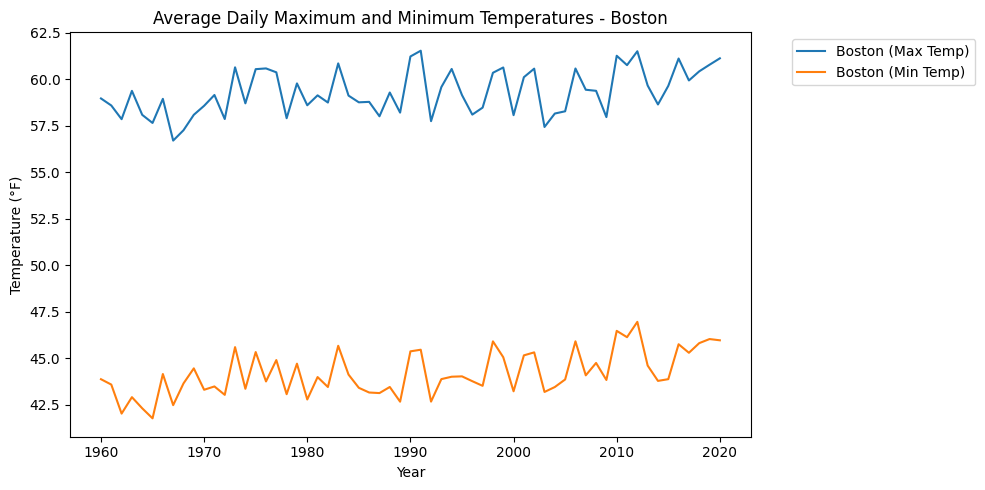

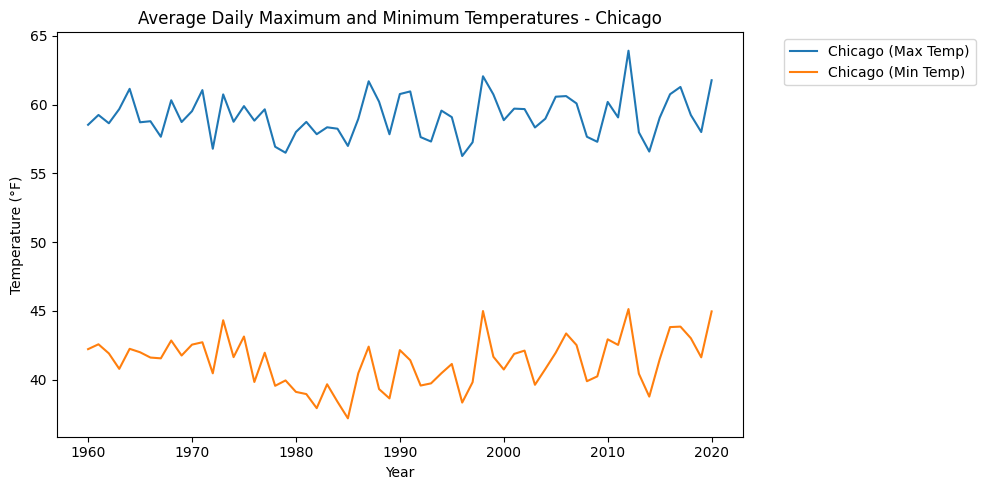

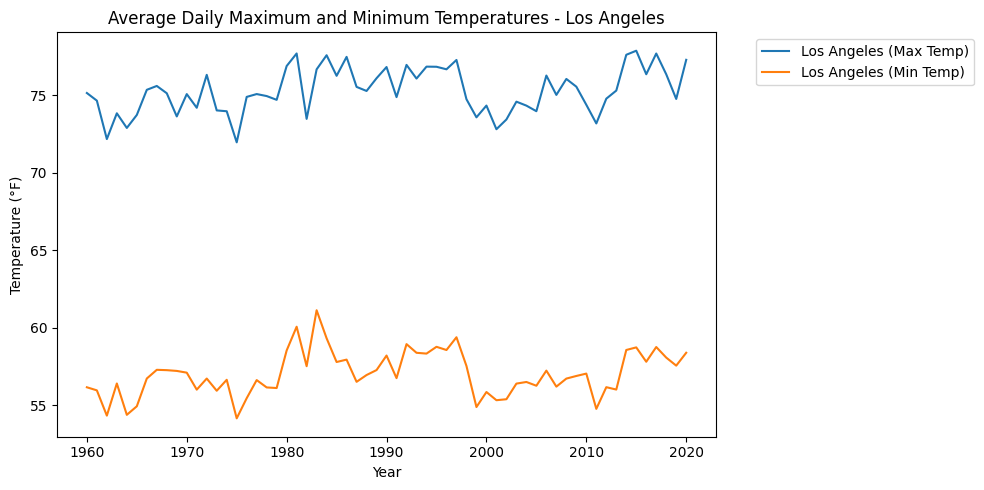

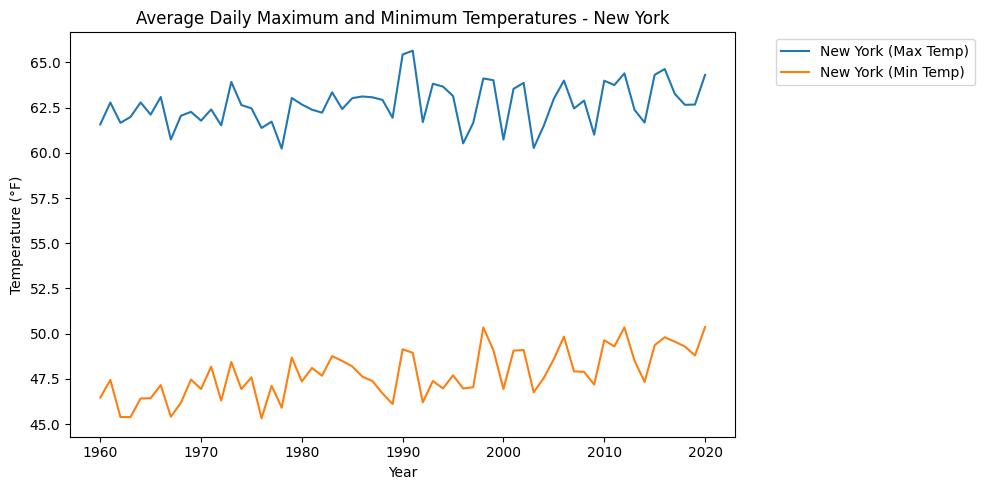

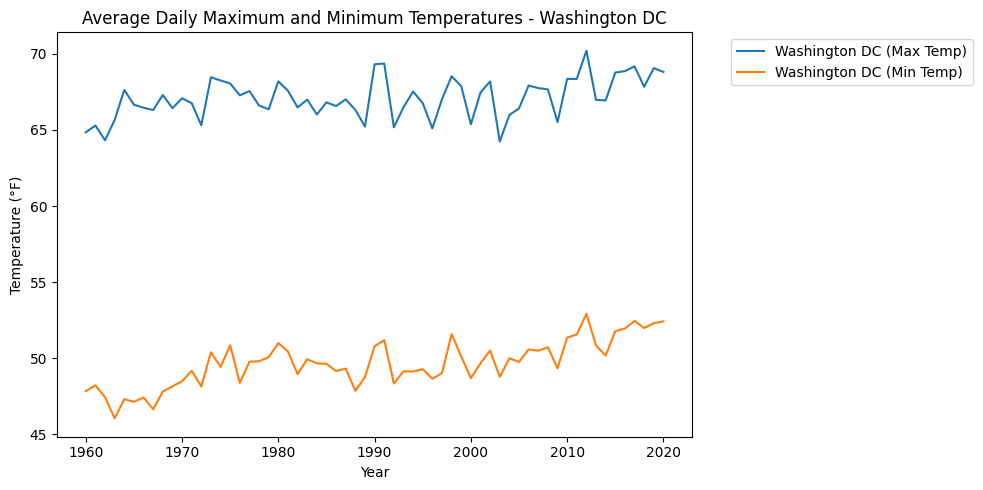

In [16]:
for city in cities:
    # Create a figure and axis object for each city
    fig, ax = plt.subplots(figsize=(10, 5))  # Set the width according to your preference

    # Filter the data for the current city
    city_data = data[data['City'] == city]

    # Calculate the average maximum and minimum temperatures for each year
    avg_max_temps = city_data.groupby(data['Year'])['tmax'].mean()
    avg_min_temps = city_data.groupby(data['Year'])['tmin'].mean()

    # Plot the average maximum and minimum temperatures as lines
    ax.plot(avg_max_temps.index, avg_max_temps, label=f'{city} (Max Temp)')
    ax.plot(avg_min_temps.index, avg_min_temps, label=f'{city} (Min Temp)')

    # Set the labels and title for the graph
    ax.set_xlabel('Year')
    ax.set_ylabel('Temperature (°F)')
    ax.set_title(f'Average Daily Maximum and Minimum Temperatures - {city}')

    # Move the legend outside the graph and prevent it from overlapping
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust the layout to make room for the legend
    fig.tight_layout()

    # Show the graph
    plt.show()


## Task 6: Plot Monthly Average Temperatures by Decades

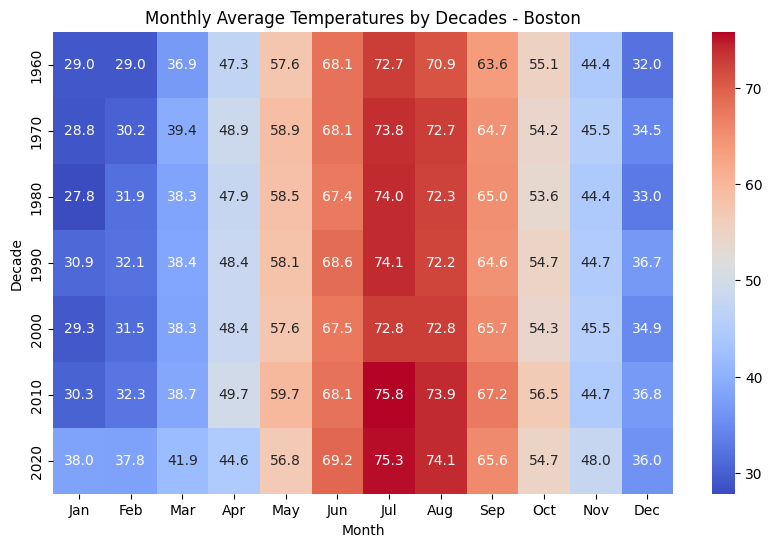

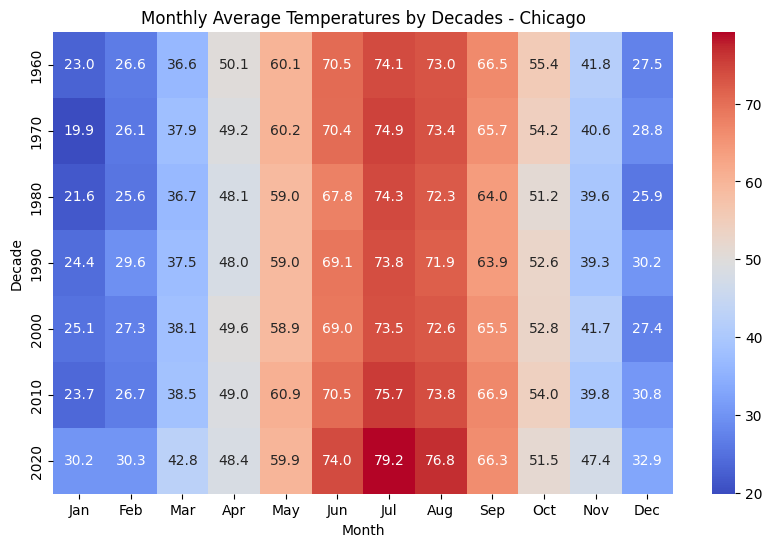

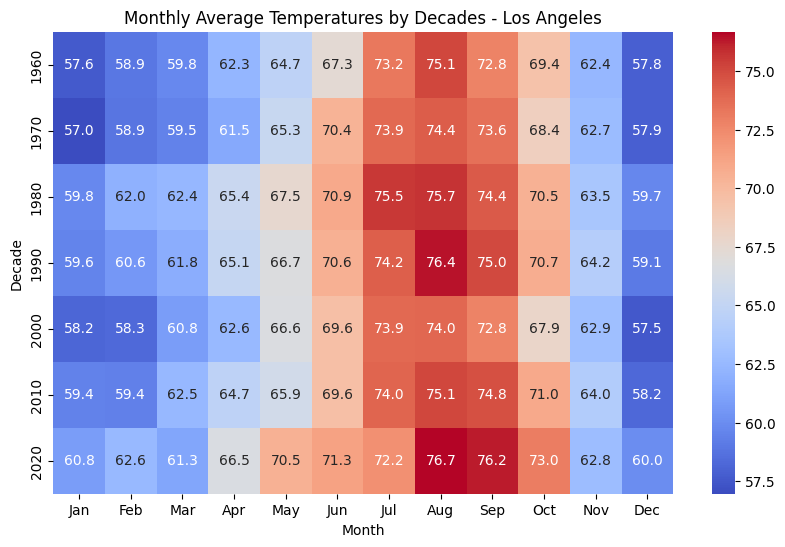

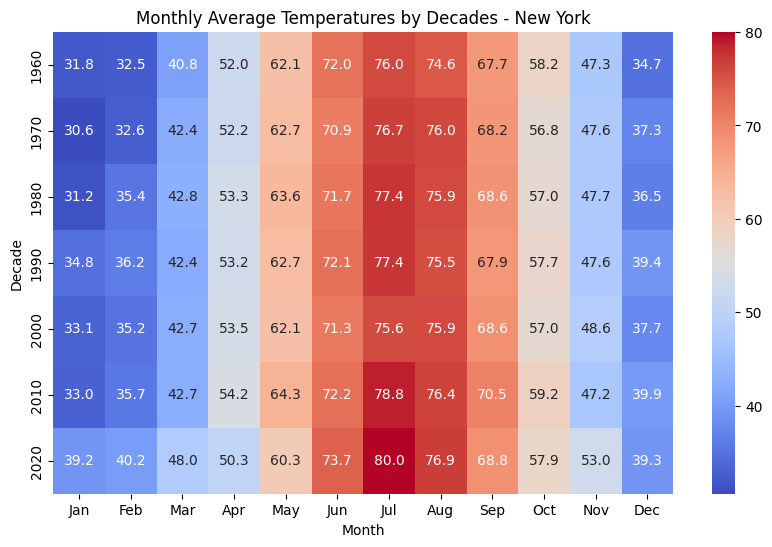

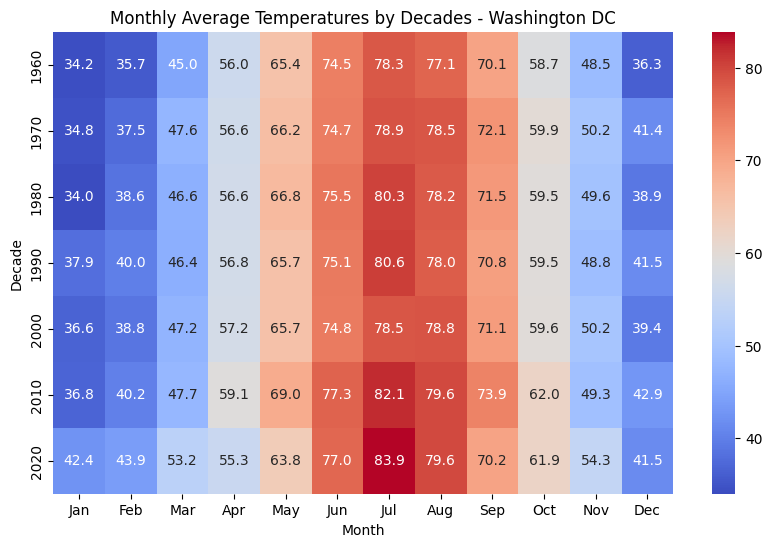

In [17]:
decades = range(data['Year'].min() // 10 * 10, data['Year'].max() // 10 * 10 + 1, 10)

# Define the order of months starting from January
month_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# Iterate over each city
for city in cities:
    # Filter the data for the current city
    city_data = data[data['City'] == city].copy()  # Make a copy of the filtered DataFrame

    # Group by decade and month, and calculate the average temperature
    city_data['Decade'] = city_data['Year'] // 10 * 10
    avg_by_decade = city_data.groupby(['Decade', 'Month']).mean(numeric_only=True).reset_index()

    # Pivot the table to reshape the data
    pivot_table = avg_by_decade.pivot(index='Decade', columns='Month', values='tavg')

    # Rearrange the columns
    pivot_table = pivot_table[month_order]

    # Set the size of the heatmap
    plt.figure(figsize=(10, 6))

    # Create the heatmap
    sns.heatmap(pivot_table, cmap='coolwarm', annot=True, fmt=".1f", cbar=True)

    # Set the title and labels
    plt.title(f"Monthly Average Temperatures by Decades - {city}")
    plt.xlabel("Month")
    plt.ylabel("Decade")

    # Show the heatmap
    plt.show()


## Task 7: Plot Average Yearly Precipitation by Cities

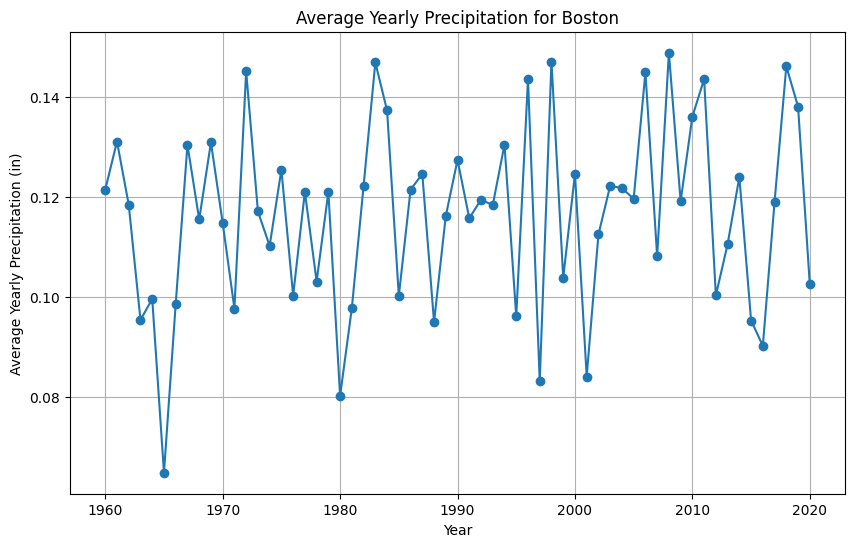

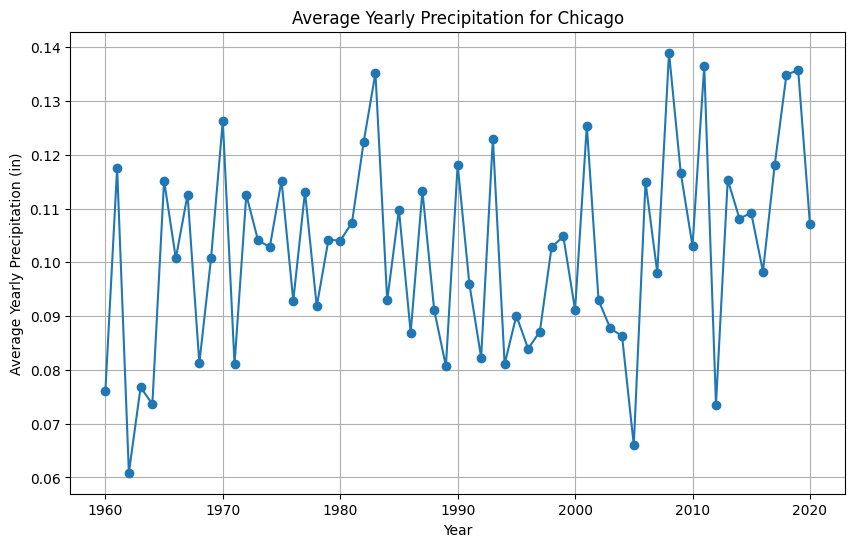

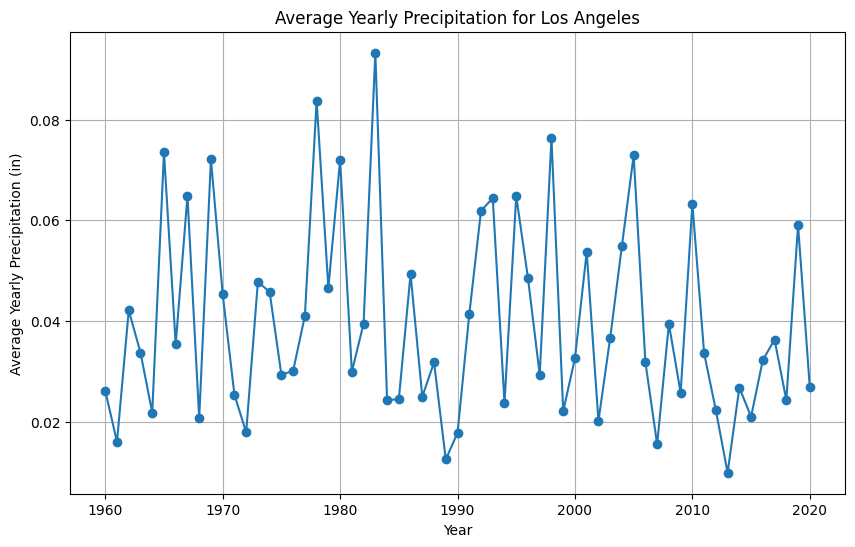

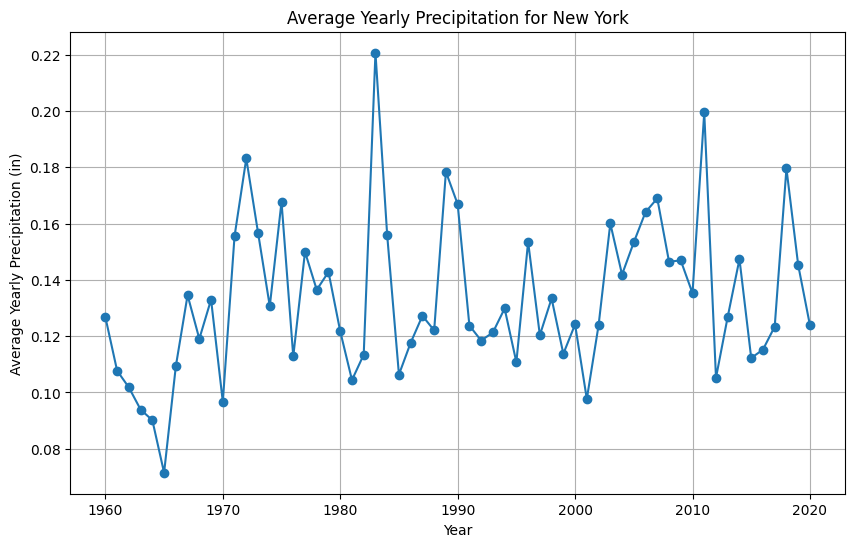

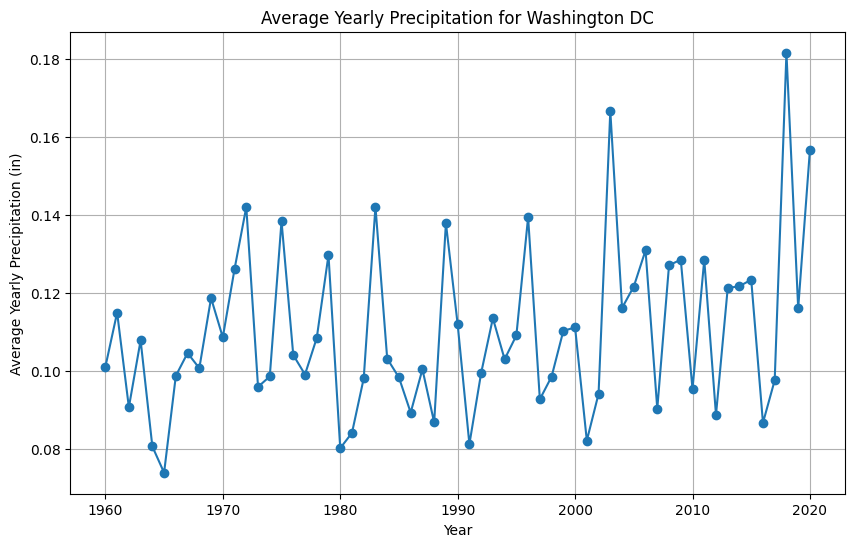

In [20]:
# Group the data by 'City' and 'Year' and calculate the average precipitation for each city and year
average_precipitation = data.groupby(['City', 'Year'])['prcp'].mean()

# Iterate over each city and create a separate plot for each
for city in cities:
    # Filter the data for the current city
    city_data = average_precipitation[city]

    # Create a list of years for the x-axis
    years = city_data.index.tolist()

    # Create a list of average precipitation values for the y-axis
    averages = city_data.tolist()

    # Set the graph size
    plt.figure(figsize=(10, 6))

    # Plot the average yearly precipitation for the current city
    plt.plot(years, averages, marker='o')

    # Set the x-axis label, y-axis label, and plot title
    plt.xlabel('Year')
    plt.ylabel('Average Yearly Precipitation (in)')
    plt.title(f'Average Yearly Precipitation for {city}')

    # Display the plot
    plt.grid(True)
    plt.show()


## Task 8: Plot Temperature and Moving Average by Cities

In [21]:
rolling_window_size = 30
for city in cities:
    city_data=data[data['City']==city]
    city_data['tavg_ma'] = city_data['tavg'].rolling(rolling_window_size).mean()
    # Create a plotly figure
    fig = go.Figure()

    # Add traces for the original temperature data and moving average
    fig.add_trace(go.Scatter(x=city_data['Date'], y=city_data['tavg'], mode='lines', name='Original Temperature'))
    fig.add_trace(go.Scatter(x=city_data['Date'], y=city_data['tavg_ma'], mode='lines', name='Moving Average'))

    # Configure the layout
    fig.update_layout(
        title=f'Temperature Data and Moving Average for {city}',
        xaxis_title='Date',
        yaxis_title='Temperature (°F)',
        hovermode='x',
        legend=dict(x=0.7, y=0.9),
        template='plotly_white'
    )

    # Show the interactive plot
    fig.show()


/tmp/ipykernel_350/2826033745.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_data['tavg_ma'] = city_data['tavg'].rolling(rolling_window_size).mean()


/tmp/ipykernel_350/2826033745.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/tmp/ipykernel_350/2826033745.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/tmp/ipykernel_350/2826033745.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/tmp/ipykernel_350/2826033745.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Task 9: Select and Rename Relevant Columns

## Task 10: Generate Weather Forecasts for Next Five Years